 ## 1. Setup and Load Data

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.offline import init_notebook_mode, iplot # Use iplot for scripts
import plotly.graph_objects as go

# Time Series Specific
from statsmodels.tsa.stattools import adfuller, kpss
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose

# Settings
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_palette('viridis')

pd.set_option('display.max_columns', 50)

# Ignore harmless warnings
import warnings
warnings.filterwarnings("ignore")

print("Libraries imported.")


Libraries imported.


In [3]:
DATA_PATH = '../data/'
train_df = pd.read_csv(f'{DATA_PATH}train.csv', parse_dates=['date'])
test_df = pd.read_csv(f'{DATA_PATH}test.csv', parse_dates=['date'])
sample_submission = pd.read_csv(f'{DATA_PATH}sample_submission.csv')

print(f'Train Data Shape: {train_df.shape}')
print(f'Test Data Shape: {test_df.shape}')


Train Data Shape: (913000, 4)
Test Data Shape: (45000, 4)


In [4]:
print('\n--- Train Data Info ---')
train_df.info()

print('\n--- Test Data Info ---')
test_df.info()



--- Train Data Info ---
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 913000 entries, 0 to 912999
Data columns (total 4 columns):
 #   Column  Non-Null Count   Dtype         
---  ------  --------------   -----         
 0   date    913000 non-null  datetime64[ns]
 1   store   913000 non-null  int64         
 2   item    913000 non-null  int64         
 3   sales   913000 non-null  int64         
dtypes: datetime64[ns](1), int64(3)
memory usage: 27.9 MB

--- Test Data Info ---
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45000 entries, 0 to 44999
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   id      45000 non-null  int64         
 1   date    45000 non-null  datetime64[ns]
 2   store   45000 non-null  int64         
 3   item    45000 non-null  int64         
dtypes: datetime64[ns](1), int64(3)
memory usage: 1.4 MB


In [5]:
print('\n--- Train Data Head ---')
print(train_df.head())



--- Train Data Head ---
        date  store  item  sales
0 2013-01-01      1     1     13
1 2013-01-02      1     1     11
2 2013-01-03      1     1     14
3 2013-01-04      1     1     13
4 2013-01-05      1     1     10


In [6]:
print(f"\nUnique Stores: {train_df['store'].nunique()}")
print(f"Unique Items: {train_df['item'].nunique()}")
print(f"Total Time Series: {train_df['store'].nunique() * train_df['item'].nunique()}")



Unique Stores: 10
Unique Items: 50
Total Time Series: 500


In [7]:
print(f"\nTrain Date Range: {train_df['date'].min()} to {train_df['date'].max()}")
print(f"Test Date Range: {test_df['date'].min()} to {test_df['date'].max()}")



Train Date Range: 2013-01-01 00:00:00 to 2017-12-31 00:00:00
Test Date Range: 2018-01-01 00:00:00 to 2018-03-31 00:00:00


 ## 2. Initial Data Preparation & Exploration

In [8]:
# Set date as index (useful for time series operations)
# Keep original df for non-indexed operations if needed
train_indexed_df = train_df.set_index('date').copy()

print("\nSet 'date' as index for train_indexed_df.")



Set 'date' as index for train_indexed_df.


In [9]:
print('\n--- Missing Values (Train) ---')
print(train_indexed_df.isnull().sum())

print('\n--- Missing Values (Test) ---')
print(test_df.isnull().sum())



--- Missing Values (Train) ---
store    0
item     0
sales    0
dtype: int64

--- Missing Values (Test) ---
id       0
date     0
store    0
item     0
dtype: int64


In [10]:
print('\n--- Sales Description ---')
print(train_indexed_df['sales'].describe())



--- Sales Description ---
count    913000.000000
mean         52.250287
std          28.801144
min           0.000000
25%          30.000000
50%          47.000000
75%          70.000000
max         231.000000
Name: sales, dtype: float64


 ## 3. Time Series Aggregation and Visualization

In [11]:
# Aggregate sales over time (all stores/items)
total_sales = train_indexed_df['sales'].resample('D').sum()

fig_total_sales = px.line(total_sales, x=total_sales.index, y='sales', title='Total Daily Sales Over Time')
fig_total_sales.update_layout(xaxis_title='Date', yaxis_title='Total Sales')

fig_total_sales.show()  

print("\nPlotted total daily sales.")



Plotted total daily sales.


 ## 4. Seasonality Analysis

In [25]:
def plot_decomposition_components(decomposition_total):

    fig_original = go.Figure()
    fig_trend = go.Figure()
    fig_seasonal = go.Figure()
    fig_residual = go.Figure()

    # Orijinals
    fig_original.add_trace(go.Scatter(x=decomposition_total.observed.index, y=decomposition_total.observed, mode='lines', name='Observed'))
    fig_original.update_layout(title='Observed (Original) Sales Data')

    # Trend 
    fig_trend.add_trace(go.Scatter(x=decomposition_total.trend.index, y=decomposition_total.trend, mode='lines', name='Trend'))
    fig_trend.update_layout(title='Trend Component')

    # Seasonal
    fig_seasonal.add_trace(go.Scatter(x=decomposition_total.seasonal.index, y=decomposition_total.seasonal, mode='lines', name='Seasonal'))
    fig_seasonal.update_layout(title='Seasonal Component')

    # Residuals
    fig_residual.add_trace(go.Scatter(x=decomposition_total.resid.index, y=decomposition_total.resid, mode='lines', name='Residual'))
    fig_residual.update_layout(title='Residual Component')

    # Plotly figures
    fig_original.show()
    fig_trend.show()
    fig_seasonal.show()
    fig_residual.show()

    print("\nPerformed and plotted seasonal decomposition for total sales using Plotly.")

# Perform decomposition using statsmodels
# Choose multiplicative model if seasonality seems proportional to the trend
decomposition_total = seasonal_decompose(total_sales, model='additive', period=365)
plot_decomposition_components(decomposition_total)


Performed and plotted seasonal decomposition for total sales using Plotly.


In [13]:
# Create time features
# Use original train_df as index is not set yet
train_df['year'] = train_df['date'].dt.year
train_df['month'] = train_df['date'].dt.month
train_df['dayofweek'] = train_df['date'].dt.dayofweek # Monday=0, Sunday=6
train_df['dayofyear'] = train_df['date'].dt.dayofyear
train_df['weekofyear'] = train_df['date'].dt.isocalendar().week.astype(int)
train_df['quarter'] = train_df['date'].dt.quarter

print("\nAdded time features (year, month, dayofweek, etc.) to train_df.")



Added time features (year, month, dayofweek, etc.) to train_df.


In [14]:
fig_weekly = px.box(train_df, x='dayofweek', y='sales',
                    title='Weekly Sales Distribution (0=Mon, 6=Sun)',
                    labels={'dayofweek': 'Day of Week', 'sales': 'Daily Sales'},
                    category_orders={"dayofweek": [0, 1, 2, 3, 4, 5, 6]})
fig_weekly.update_layout(yaxis_title='Sales')
# fig_weekly.show()
iplot(fig_weekly)
print("Plotted weekly sales distribution.")


Plotted weekly sales distribution.


In [15]:
fig_monthly = px.box(train_df, x='month', y='sales',
                     title='Monthly Sales Distribution',
                     labels={'month': 'Month', 'sales': 'Daily Sales'})
fig_monthly.update_layout(yaxis_title='Sales')
# fig_monthly.show()
iplot(fig_monthly)
print("Plotted monthly sales distribution.")



Plotted monthly sales distribution.


In [16]:
yearly_avg_sales = train_df.groupby('dayofyear')['sales'].mean()
fig_yearly_avg = px.line(yearly_avg_sales, x=yearly_avg_sales.index, y='sales',
                        title='Average Daily Sales Across the Year',
                        labels={'dayofyear': 'Day of Year', 'sales': 'Average Sales'})
# fig_yearly_avg.show()
iplot(fig_yearly_avg)
print("Plotted average daily sales across the year.")



Plotted average daily sales across the year.


In [17]:
yearly_total_sales = train_df.groupby('year')['sales'].sum()
fig_yearly_total = px.bar(yearly_total_sales, x=yearly_total_sales.index, y='sales',
                          title='Total Sales per Year',
                          labels={'year': 'Year', 'sales': 'Total Sales'})
# fig_yearly_total.show()
iplot(fig_yearly_total)
print("Plotted total sales per year.")



Plotted total sales per year.


 ## 5. Autocorrelation Analysis

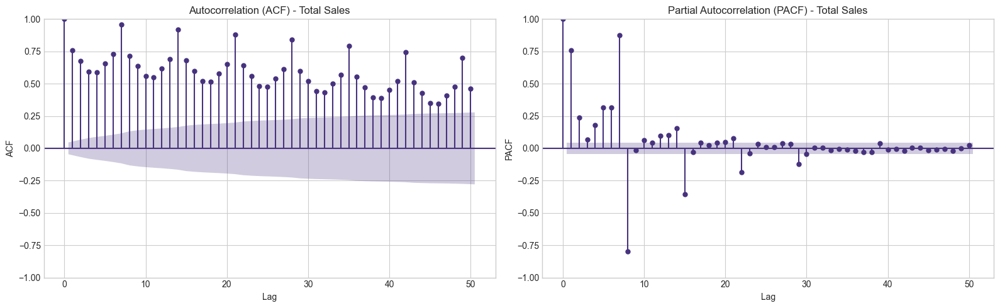


Plotted ACF and PACF for total sales.


In [18]:
fig_acf_pacf, axes = plt.subplots(1, 2, figsize=(16, 5))

# ACF Plot
plot_acf(total_sales, lags=50, ax=axes[0], title='Autocorrelation (ACF) - Total Sales')
axes[0].set_xlabel("Lag")
axes[0].set_ylabel("ACF")

# PACF Plot
plot_pacf(total_sales, lags=50, ax=axes[1], title='Partial Autocorrelation (PACF) - Total Sales')
axes[1].set_xlabel("Lag")
axes[1].set_ylabel("PACF")

plt.tight_layout()
plt.show()

print("\nPlotted ACF and PACF for total sales.")


 ## 6. Stationarity Tests

In [19]:
def run_stationarity_tests(series, series_name=""):
    """Performs ADF and KPSS tests and prints the results."""
    print(f'--- Stationarity Tests for {series_name} ---')

    # ADF Test (Null: Non-stationary)
    adf_result = adfuller(series.dropna())
    print(f'ADF Statistic: {adf_result[0]:.4f}')
    print(f'p-value: {adf_result[1]:.4f}')
    print('Critical Values:')
    for key, value in adf_result[4].items():
        print(f'\t{key}: {value:.4f}')
    if adf_result[1] <= 0.05:
        print("=> ADF Result: Reject Null Hypothesis (Series is likely Stationary)")
    else:
        print("=> ADF Result: Fail to Reject Null Hypothesis (Series is likely Non-Stationary)")

    print('\n')

    # KPSS Test (Null: Stationary)
    kpss_result = kpss(series.dropna(), regression='c') # 'c' for constant (level stationarity)
    print(f'KPSS Statistic: {kpss_result[0]:.4f}')
    print(f'p-value: {kpss_result[1]:.4f}')
    print('Critical Values:')
    for key, value in kpss_result[3].items():
        print(f'\t{key}: {value:.4f}')
    if kpss_result[1] < 0.05:
        print("=> KPSS Result: Reject Null Hypothesis (Series is likely Non-Stationary)")
    else:
        print("=> KPSS Result: Fail to Reject Null Hypothesis (Series is likely Stationary)")
    print('--------------------------------------------\n')


In [20]:
run_stationarity_tests(total_sales, "Total Daily Sales")


--- Stationarity Tests for Total Daily Sales ---
ADF Statistic: -3.0602
p-value: 0.0296
Critical Values:
	1%: -3.4340
	5%: -2.8631
	10%: -2.5676
=> ADF Result: Reject Null Hypothesis (Series is likely Stationary)


KPSS Statistic: 2.0010
p-value: 0.0100
Critical Values:
	10%: 0.3470
	5%: 0.4630
	2.5%: 0.5740
	1%: 0.7390
=> KPSS Result: Reject Null Hypothesis (Series is likely Non-Stationary)
--------------------------------------------



In [21]:
# total_sales_diff = total_sales.diff().dropna()
# run_stationarity_tests(total_sales_diff, "Differenced Total Daily Sales")
# Note: Uncomment the lines above if the original series is found non-stationary


 ## 7. Individual Series Analysis (Example: Store 1, Item 1)

In [22]:
store_id = 1
item_id = 1
single_series = train_indexed_df[(train_indexed_df['store'] == store_id) & (train_indexed_df['item'] == item_id)]['sales']

print(f"\nAnalyzing Store {store_id}, Item {item_id}. Shape: {single_series.shape}")



Analyzing Store 1, Item 1. Shape: (1826,)


In [23]:
fig_single = px.line(x=single_series.index, y=single_series.values, title=f'Daily Sales for Store {store_id}, Item {item_id}')
fig_single.update_layout(xaxis_title='Date', yaxis_title='Sales')
# fig_single.show()
iplot(fig_single)
print("Plotted individual series sales.")


Plotted individual series sales.


In [26]:
try:
    # Ensure enough data points for decomposition period (e.g., 2 years for period=365)
    if len(single_series) > 2 * 365:
        decomposition_single = seasonal_decompose(single_series, model='additive', period=365)
        plot_decomposition_components(decomposition_single)
        print(f"Performed and plotted seasonal decomposition for Store {store_id}, Item {item_id}.")
    else:
        print(f"Skipping decomposition for Store {store_id}, Item {item_id} due to insufficient data for period 365.")
except Exception as e:
    print(f"Error during decomposition for Store {store_id}, Item {item_id}: {e}")




Performed and plotted seasonal decomposition for total sales using Plotly.
Performed and plotted seasonal decomposition for Store 1, Item 1.


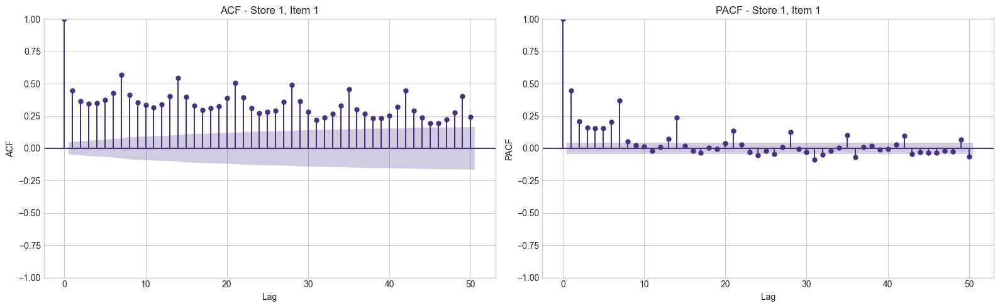


Plotted ACF and PACF for Store 1, Item 1.


In [27]:
fig_acf_pacf_single, axes_single = plt.subplots(1, 2, figsize=(16, 5))

# ACF Plot
plot_acf(single_series, lags=50, ax=axes_single[0], title=f'ACF - Store {store_id}, Item {item_id}')
axes_single[0].set_xlabel("Lag")
axes_single[0].set_ylabel("ACF")

# PACF Plot
plot_pacf(single_series, lags=50, ax=axes_single[1], title=f'PACF - Store {store_id}, Item {item_id}')
axes_single[1].set_xlabel("Lag")
axes_single[1].set_ylabel("PACF")

plt.tight_layout()
plt.show()
print(f"\nPlotted ACF and PACF for Store {store_id}, Item {item_id}.")



In [28]:
run_stationarity_tests(single_series, f"Store {store_id}, Item {item_id} Sales")


--- Stationarity Tests for Store 1, Item 1 Sales ---
ADF Statistic: -3.1577
p-value: 0.0226
Critical Values:
	1%: -3.4340
	5%: -2.8631
	10%: -2.5676
=> ADF Result: Reject Null Hypothesis (Series is likely Stationary)


KPSS Statistic: 1.8914
p-value: 0.0100
Critical Values:
	10%: 0.3470
	5%: 0.4630
	2.5%: 0.5740
	1%: 0.7390
=> KPSS Result: Reject Null Hypothesis (Series is likely Non-Stationary)
--------------------------------------------



In [29]:
import pandas as pd
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt

# Assume 'your_series' is a pandas Series with a DatetimeIndex
# Example:
# data = pd.read_csv('your_data.csv', index_col='Date', parse_dates=True)
# your_series = data['Value']

# --- Key Parameters ---
# model: 'additive' or 'multiplicative'
#   - Choose 'additive' if the seasonal variations are roughly constant over time.
#   - Choose 'multiplicative' if the seasonal variations change proportionally
#     to the level of the series (e.g., fluctuations get bigger as the trend increases).
# period: The number of observations in a full seasonal cycle.
#   - e.g., 12 for monthly data with yearly seasonality
#   - e.g., 7 for daily data with weekly seasonality
#   - e.g., 4 for quarterly data with yearly seasonality
#   - This MUST be set correctly based on your data's known frequency.

# --- Perform Decomposition ---
# Example using additive model for monthly data (period=12)
try:
    decomposition_result = seasonal_decompose(
        train_df[(train_df['store']== 1) & (train_df['item']== 1)]['sales'].copy(),
        model='additive',  # Or 'multiplicative'
        period=12,         # Adjust based on your data's frequency
        extrapolate_trend='freq' # Often useful to avoid NaNs at ends
    )

    # --- Plot the results ---
    plot_decomposition_components(decomposition_result)
    
    # --- Access individual components ---
    trend = decomposition_result.trend
    seasonal = decomposition_result.seasonal
    residual = decomposition_result.resid # or .residual
    observed = decomposition_result.observed # This is just your original series

    print("\nTrend Component Head:")
    print(trend.head())
    print("\nSeasonal Component Head:")
    print(seasonal.head())
    print("\nResidual Component Head:")
    print(residual.head())

except ValueError as e:
    print(f"Error during decomposition: {e}")
    print("Ensure your series has enough data points (at least 2 full periods) and the period is set correctly.")


Performed and plotted seasonal decomposition for total sales using Plotly.

Trend Component Head:
0    10.222514
1    10.210713
2    10.198912
3    10.187111
4    10.175311
Name: trend, dtype: float64

Seasonal Component Head:
0    0.088200
1   -0.351648
2    0.292342
3    0.237321
4   -0.266713
Name: seasonal, dtype: float64

Residual Component Head:
0    2.689287
1    1.140935
2    3.508745
3    2.575567
4    0.091402
Name: resid, dtype: float64


 ## 8. Further Exploration Ideas



 - **Distribution of Sales:** Plot histograms or density plots of sales (overall, per store, per item).

 - **Zero Sales Analysis:** Investigate the frequency and patterns of days with zero sales.

 - **Store/Item Level Aggregations:** Compare average sales, trends, and seasonality across different stores and items (e.g., top/bottom performers).

 - **Cross-Correlation:** Analyze if sales of certain items/stores are correlated (might require sampling due to the number of series).

 - **Impact of Holidays/Events:** (Requires external data) Analyze sales patterns around specific dates.

### 8.1 Distribution of Sales

In [33]:
# Overall Sales Distribution (Histogram)
fig_sales_dist = px.histogram(train_df, x='sales', nbins=100,
                            title='Overall Distribution of Daily Sales')
fig_sales_dist.update_layout(xaxis_title='Daily Sales', yaxis_title='Frequency')
iplot(fig_sales_dist)
print("Plotted overall sales distribution.")

# Note: Plotting per store or item might be too many plots (500 series).
# Consider sampling or focusing on specific stores/items if needed.
# Example for Store 1:
store1_sales = train_df[train_df['store'] == 10]
fig_store1_dist = px.histogram(store1_sales, x='sales', nbins=50, title='Sales Distribution for Store 10')
iplot(fig_store1_dist)

Plotted overall sales distribution.


### 8.2 Zero Sales Analysis

In [36]:
# Calculate overall percentage of zero sales days
zero_sales_days = (train_df['sales'] == 0).sum()
total_days = train_df.shape[0]
zero_sales_percentage = (zero_sales_days / total_days) * 100
print(f"Overall percentage of zero sales days: {zero_sales_percentage:.2f}%")

# Count zero sales days per store
zero_sales_per_store = train_df[train_df['sales'] == 0].groupby('store').size()
print("\n--- Zero Sales Days Count per Store (Top 10) ---")
print(zero_sales_per_store.sort_values(ascending=False).head(10))

# Count zero sales days per item
zero_sales_per_item = train_df[train_df['sales'] == 0].groupby('item').size()
print("\n--- Zero Sales Days Count per Item (Top 10) ---")
print(zero_sales_per_item.sort_values(ascending=False).head(10))

Overall percentage of zero sales days: 0.00%

--- Zero Sales Days Count per Store (Top 10) ---
store
6    1
dtype: int64

--- Zero Sales Days Count per Item (Top 10) ---
item
4    1
dtype: int64


### 8.3 Store/Item Level Aggregations

In [37]:
# Average sales per store
avg_sales_store = train_df.groupby('store')['sales'].mean().sort_values(ascending=False)
fig_avg_store = px.bar(avg_sales_store, x=avg_sales_store.index, y='sales',
                       title='Average Daily Sales per Store',
                       labels={'index': 'Store ID', 'sales': 'Average Sales'})
iplot(fig_avg_store)
print("\nPlotted average sales per store.")

# Average sales per item
avg_sales_item = train_df.groupby('item')['sales'].mean().sort_values(ascending=False)
fig_avg_item = px.bar(avg_sales_item, x=avg_sales_item.index, y='sales',
                      title='Average Daily Sales per Item',
                      labels={'index': 'Item ID', 'sales': 'Average Sales'})
iplot(fig_avg_item)
print("\nPlotted average sales per item.")

# Top 5 performing items (by average sales)
print("\n--- Top 5 Items by Average Sales ---")
print(avg_sales_item.head())

# Bottom 5 performing items (by average sales)
print("\n--- Bottom 5 Items by Average Sales ---")
print(avg_sales_item.tail())


Plotted average sales per store.



Plotted average sales per item.

--- Top 5 Items by Average Sales ---
item
15    88.030778
28    87.881325
13    84.316594
18    84.275794
25    80.686418
Name: sales, dtype: float64

--- Bottom 5 Items by Average Sales ---
item
4     22.010241
47    22.003341
41    22.002136
1     21.981599
5     18.358708
Name: sales, dtype: float64


### 8.4 Cross-Correlation (Sample)

In [38]:
# Cross-correlation is computationally intensive for all 500 series.
# Let's demonstrate with a small sample (e.g., Item 1 across first 3 stores)
sample_series = {}
item_to_analyze = 1
stores_to_analyze = [1, 2, 3]

for store_id in stores_to_analyze:
    mask = (train_df['store'] == store_id) & (train_df['item'] == item_to_analyze)
    # Ensure date is the index before accessing 'sales'
    series = train_df.loc[mask].set_index('date')['sales']
    sample_series[f'Store{store_id}_Item{item_to_analyze}'] = series

sample_df = pd.DataFrame(sample_series)

# Calculate the correlation matrix
correlation_matrix = sample_df.corr()

print(f"\n--- Correlation Matrix for Item {item_to_analyze} across Stores {stores_to_analyze} ---")
print(correlation_matrix)

# Visualize the correlation matrix
fig_corr = px.imshow(correlation_matrix, text_auto=True, aspect="auto",
                     title=f'Correlation Matrix for Item {item_to_analyze} across Stores {stores_to_analyze}')
iplot(fig_corr)


--- Correlation Matrix for Item 1 across Stores [1, 2, 3] ---
              Store1_Item1  Store2_Item1  Store3_Item1
Store1_Item1      1.000000      0.604362      0.586030
Store2_Item1      0.604362      1.000000      0.610618
Store3_Item1      0.586030      0.610618      1.000000


### 8.5 Impact of Holidays/Events

Analyzing the impact of holidays requires an external dataset containing holiday dates relevant to the stores' locations (assuming US holidays initially is common if location isn't specified).

**Steps:**
1.  **Obtain Holiday Data:** Find or create a DataFrame with dates and holiday names (e.g., using libraries like `holidays` in Python).
2.  **Merge Data:** Merge the holiday data with the `train_df` based on the date.
3.  **Analyze:**
    *   Compare average sales on holidays vs. non-holidays.
    *   Plot sales trends around specific major holidays (e.g., days leading up to and following the holiday).
    *   Use box plots to compare sales distributions on different holidays or holiday vs. non-holiday.




In [39]:
import holidays

# Assuming US holidays
us_holidays = holidays.US(years=train_df['year'].unique())
holiday_df = pd.DataFrame(list(us_holidays.items()), columns=['date', 'holiday'])
holiday_df['date'] = pd.to_datetime(holiday_df['date'])

# Merge with training data
# Ensure train_df has the 'date' column (if it was set as index earlier, reset it or use the original df)
train_df_holidays = pd.merge(train_df, holiday_df, on='date', how='left')
train_df_holidays['is_holiday'] = ~train_df_holidays['holiday'].isna()

# Analyze sales on holidays vs non-holidays
print(train_df_holidays.groupby('is_holiday')['sales'].mean())

# Plot comparison (e.g., using box plot)
fig_holiday_impact = px.box(train_df_holidays, x='is_holiday', y='sales',
                            title='Sales Distribution: Holiday vs. Non-Holiday',
                            labels={'is_holiday': 'Is Holiday?', 'sales':'Daily Sales'})
iplot(fig_holiday_impact)

is_holiday
False    52.490017
True     44.383593
Name: sales, dtype: float64
